<a href="https://colab.research.google.com/github/otnemrasordep/DadaGP-track-processing/blob/main/audio_do.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

A few coding scribbles on audio matters.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# dealing with audio

In [ ]:
!pip install torchaudio matplotlib

In [ ]:
!python --version

Python 3.10.12


In [ ]:
!cd /content/drive/MyDrive/audio-do/mirelo-interview

In [ ]:
from IPython.display import Audio
import torchaudio
import os
import matplotlib.pyplot as plt
import torch
import librosa

In [ ]:
# Declare paths
mirelo_path = '/content/drive/MyDrive/audio-do/mirelo-interview'
snippet1_path = os.path.join(mirelo_path, 'snippet1_Mirelo.mp3')
snippet2_path = os.path.join(mirelo_path, 'snippet2_Mirelo.mp3')
zeal_path = os.path.join(mirelo_path, 'zealArdor_Götterdämmerung.mp3')

In [ ]:
# Load audio (from Mirelo)
waveform1, sample_rate1 = torchaudio.load(snippet1_path)
waveform2, sample_rate2 = torchaudio.load(snippet2_path)

In [ ]:
print(f'Snippet1: {waveform1.size(dim=0)} channel(s), with {waveform1.size(dim=-1)} samples, with a {sample_rate1}Hz sample rate.')
Audio(snippet1_path)

Snippet1: 2 channel(s), with 960815 samples, with a 48000Hz sample rate.


In [ ]:
print(f'Snippet2: {waveform2.size(dim=0)} channel(s), with {waveform2.size(dim=-1)} samples, with a {sample_rate2}Hz sample rate.')
Audio(snippet2_path)

Snippet2: 1 channel(s), with 720047 samples, with a 48000Hz sample rate.


### conversion to .mp3

In [ ]:
!pip install pydub

In [ ]:
!apt-get install ffmpeg

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


In [ ]:
!pip install audioread

In [ ]:
# used to convert .wav to .mp3

# from pydub import AudioSegment
# from pydub.playback import play

# # Manually set codec
# audio = AudioSegment.from_file(zeal_path, format="wav", codec="adpcm_ms")
# audio.export(os.path.join(mirelo_path,"zealArdor_Götterdämmerung.mp3" ), format="mp3")

# visualize the audio

from https://pytorch.org/audio/stable/transforms.html

![](https://download.pytorch.org/torchaudio/tutorial-assets/torchaudio_feature_extractions.png)

## time domain representations

### waveform

In [ ]:
# with torch
def load_audio_plot_waveform_torch(file_path, color='blue', title="Waveform"):
    # Load audio with torchaudio
    waveform, sample_rate = torchaudio.load(file_path)

    # Generate time axis in seconds
    num_samples = waveform.shape[-1]
    time_axis = torch.linspace(0, num_samples / sample_rate, steps=num_samples)

    print(f"Waveform shape: {waveform.type} {waveform.shape}")

    # Plot the waveform
    plt.figure(figsize=(15, 4))
    plt.plot(time_axis.numpy(), waveform.t().numpy(), color=color)
    plt.title(f"{title} (Sample Rate: {sample_rate} Hz)")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.show()

    return

In [ ]:
import librosa
import matplotlib.pyplot as plt
import numpy as np

def load_audio_plot_waveform_librosa(file_path, color='blue', title="Waveform"):
    # Load audio with librosa
    y, sr = librosa.load(file_path, sr=None)  # Automatically resample if needed

    # Generate time axis in seconds
    num_samples = len(y)
    time_axis = np.linspace(0, num_samples / sr, num=num_samples)

    print(f"Waveform shape: {y.dtype} {y.shape}")

    # Plot the waveform
    plt.figure(figsize=(15, 4))
    plt.plot(time_axis, y, color=color)
    plt.title(f"{title} (Sample Rate: {sr} Hz)")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.show()

    return

Waveform shape: <built-in method type of Tensor object at 0x7bd41a1cefc0> torch.Size([2, 960815])


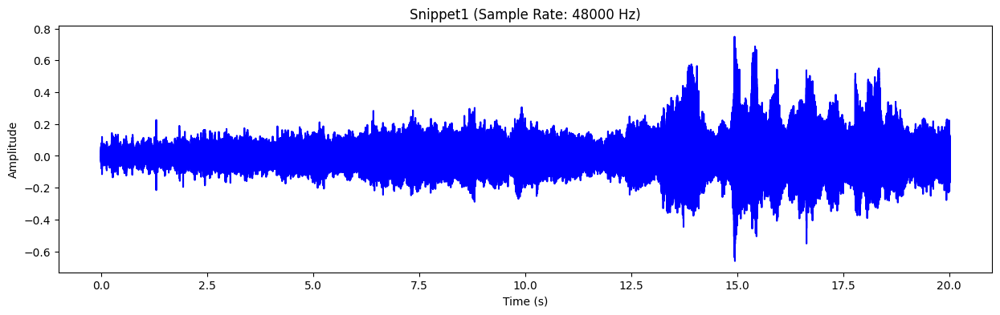

Waveform shape: float32 (960815,)


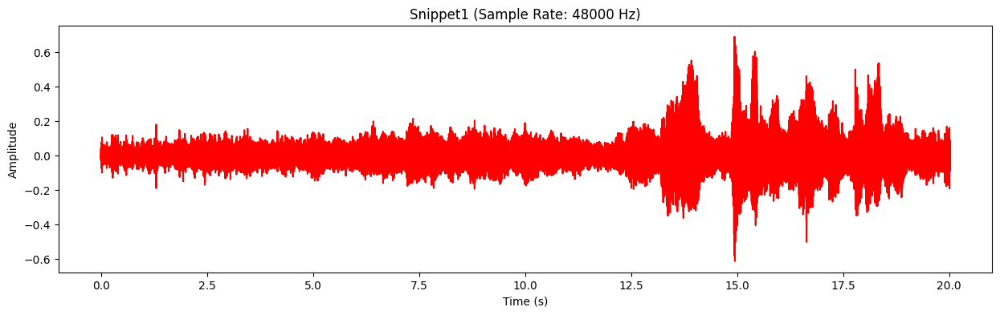

In [ ]:
load_audio_plot_waveform_torch(snippet1_path, color='blue', title="Snippet1")
load_audio_plot_waveform_librosa(snippet1_path, color='red', title="Snippet1")

Waveform shape: <built-in method type of Tensor object at 0x7bd405b71030> torch.Size([1, 720047])


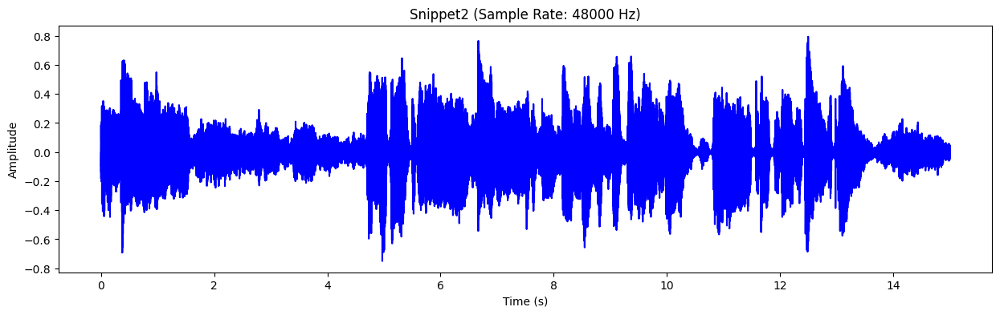

Waveform shape: float32 (720047,)


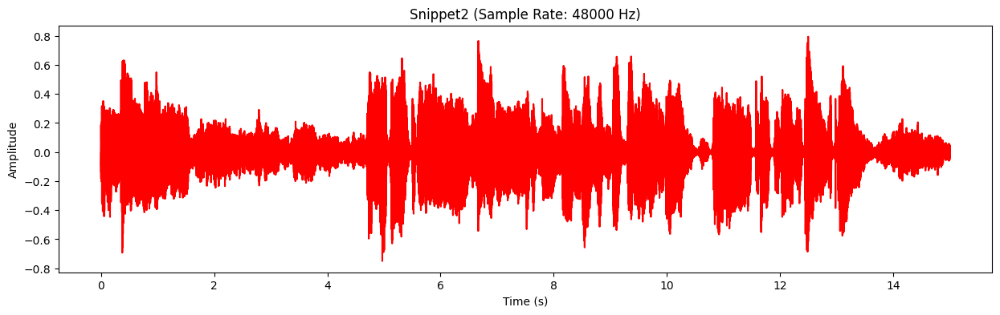

In [ ]:
load_audio_plot_waveform_torch(snippet2_path, color='blue', title="Snippet2")
load_audio_plot_waveform_librosa(snippet2_path, color='red', title="Snippet2")

## frequency domain representation

### spectrogram

In [ ]:
# with torch
import torchaudio.transforms as T
import math

# Function to load some audio and plot the spectrogram
def load_audio_plot_spectrogram_torch(file_path, title="Spectrogram", n_fft=1024, hop_length=512):
    # Load audio with torchaudio
    waveform, sample_rate = torchaudio.load(file_path)

    # Create a spectrogram transform
    spectrogram_transform = T.Spectrogram(n_fft=n_fft, hop_length=hop_length)

    # Apply transform to waveform
    spectrogram = spectrogram_transform(waveform)

     # Calculate expected number of time frames
    # num_time_frames = math.ceil((waveform.size(1) - n_fft) / hop_length) + 1
    # print(f"Expected Time Frames: {num_time_frames}")
    # print(f"Actual Time Frames (from spectrogram): {spectrogram.shape[-1]}")
    print(f"Spectrogram shape: {spectrogram.type} {spectrogram.shape}")

    # Plot the spectrogram
    plt.figure(figsize=(15, 6))
    plt.imshow(spectrogram.log2()[0].numpy(), aspect='auto', origin='lower') # applies log on the first channel, converts to numpy
    plt.title(f" Spectrogram:  {title} (Sample Rate: {sample_rate} Hz)")
    plt.xlabel("Time Frames")
    plt.ylabel("Frequency Bins")
    plt.colorbar(label="Log Amplitude")
    plt.show()

    return


In [ ]:
# with librosa
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

def load_audio_plot_spectrogram_librosa(file_path, title="Spectrogram", n_fft=1024, hop_length=512):
    # Load audio with librosa
    y, sr = librosa.load(file_path, sr=None)

    # Compute the spectrogram (STFT)
    stft = librosa.stft(y, n_fft=n_fft, hop_length=hop_length)

    # Convert to magnitude (absolute value)
    spectrogram = np.abs(stft)

    # Apply log scale (logarithmic amplitude)
    log_spectrogram = librosa.amplitude_to_db(spectrogram, ref=np.max)

    print(f"Spectrogram shape: {log_spectrogram.dtype} {log_spectrogram.shape}")

    # Plot the spectrogram
    plt.figure(figsize=(15, 6))
    librosa.display.specshow(
        log_spectrogram,
        sr=sr,
        hop_length=hop_length,
        x_axis='time',
        y_axis='linear',
        cmap='coolwarm'
    )
    plt.title(f"Spectrogram: {title} (Sample Rate: {sr} Hz)")
    plt.colorbar(format="%+2.0f dB", label="Log Amplitude")
    plt.xlabel("Time (s)")
    plt.ylabel("Frequency (Hz)")
    plt.show()

    return


Spectrogram shape: <built-in method type of Tensor object at 0x7bd405aedf80> torch.Size([2, 513, 1877])


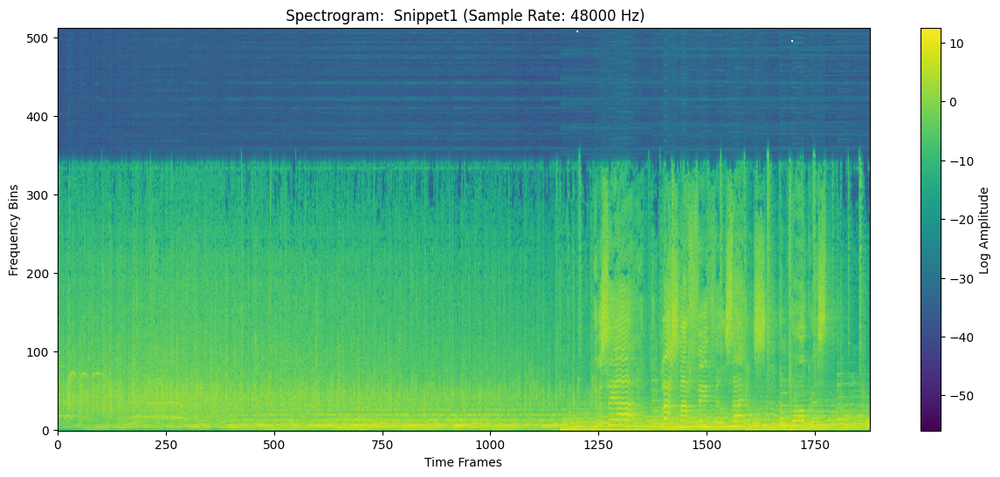

Spectrogram shape: float32 (513, 1877)


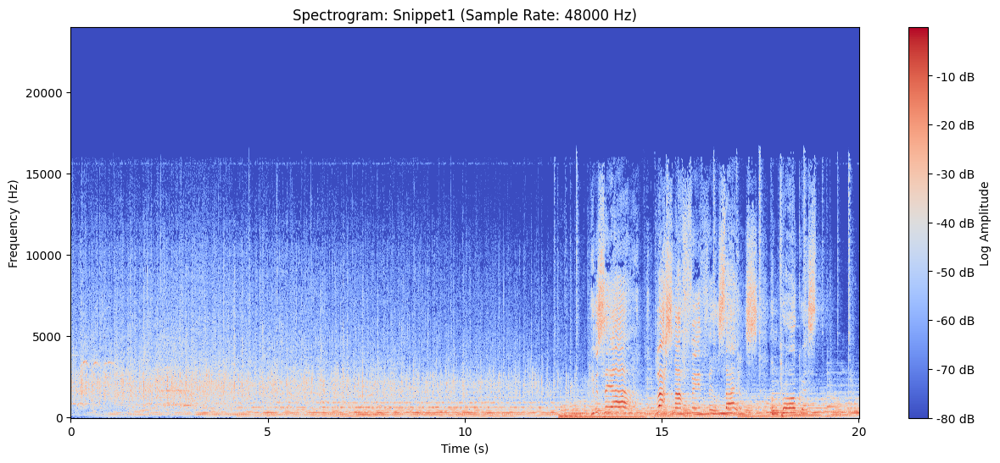

In [ ]:
load_audio_plot_spectrogram_torch(snippet1_path, title="Snippet1", n_fft=1024, hop_length=512)
load_audio_plot_spectrogram_librosa(snippet1_path, title="Snippet1", n_fft=1024, hop_length=512)

Spectrogram shape: <built-in method type of Tensor object at 0x7bd4062809a0> torch.Size([1, 513, 1407])


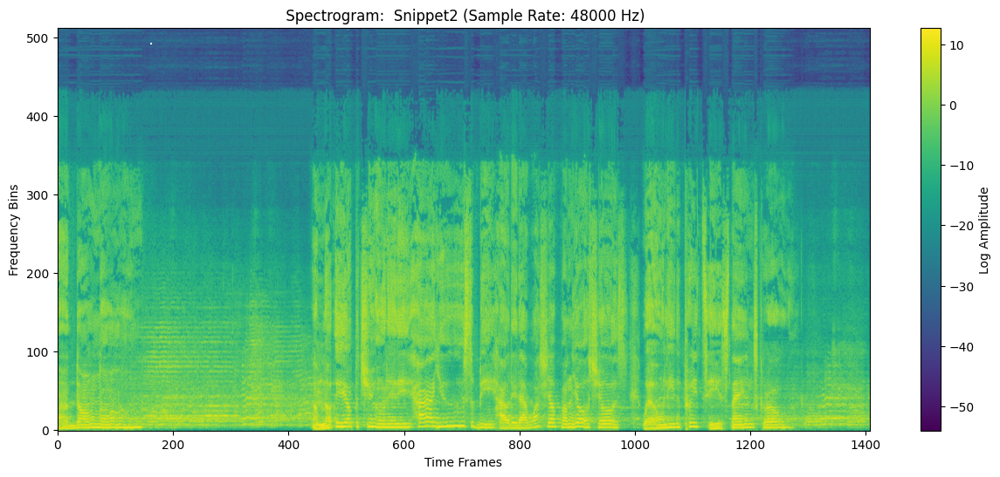

Spectrogram shape: float32 (513, 1407)


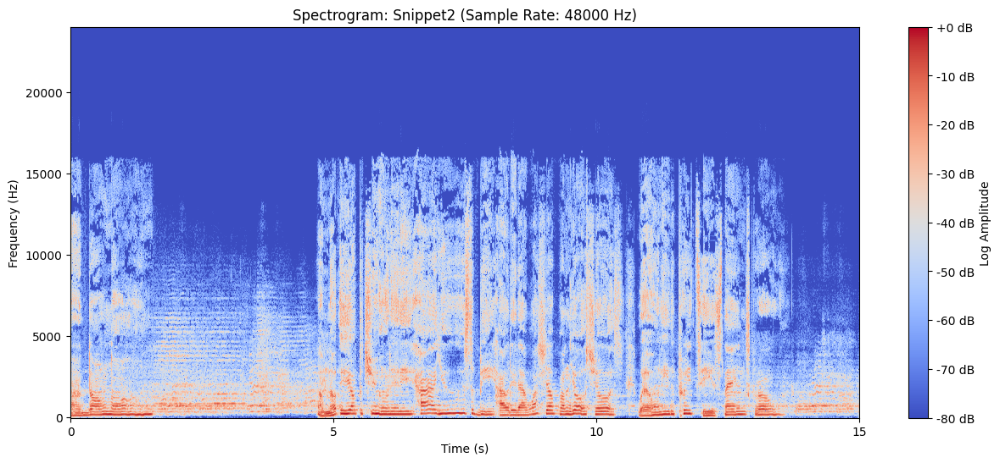

In [ ]:
load_audio_plot_spectrogram_torch(snippet2_path, title="Snippet2", n_fft=1024, hop_length=512)
load_audio_plot_spectrogram_librosa(snippet2_path, title="Snippet2", n_fft=1024, hop_length=512)

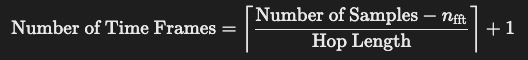

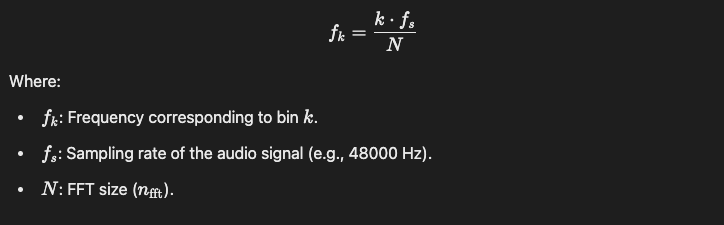

### mel-spectrogram


In [ ]:
# with torch
import torchaudio.transforms as T
import math

def load_audio_plot_melspec_torch(file_path, title="MelSpectrogram", n_fft=1024, hop_length=512, n_mels=128):
    # Load audio with torchaudio
    waveform, sample_rate = torchaudio.load(file_path)

    # Create a melspectrogram transform
    mel_transform = T.MelSpectrogram(sample_rate=sample_rate, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)

    # Apply transform to waveform
    mel_spectrogram = mel_transform(waveform)

    print(f"Spectrogram shape: {mel_spectrogram.type} {mel_spectrogram.shape}")

    # Plot the Mel spectrogram
    plt.figure(figsize=(15, 6))
    plt.imshow(mel_spectrogram.log2()[0].detach().numpy(), aspect='auto', origin='lower')
    plt.title(f"Mel-Spectrogram:  {title} (Sample Rate: {sample_rate} Hz)")
    plt.xlabel("Time Frames")
    plt.ylabel("Mel Bands")
    plt.colorbar(label="Log Amplitude")
    plt.show()

    return

In [ ]:
# with librosa
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

def load_audio_plot_melspec_librosa(file_path, title="MelSpectrogram", n_fft=1024, hop_length=512, n_mels=128):

    # Load audio with librosa
    y, sr = librosa.load(file_path, sr=None)  # Automatically resample if needed

    # Compute Mel spectrogram
    mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)

    # Convert to log scale (logarithmic amplitude)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    print(f"Spectrogram shape: {log_mel_spectrogram.dtype} {log_mel_spectrogram.shape}")

    # Plot the Mel spectrogram
    plt.figure(figsize=(15, 6))
    librosa.display.specshow(log_mel_spectrogram, sr=sr, hop_length=hop_length, x_axis='time', y_axis='mel', cmap='coolwarm')
    plt.title(f"Mel-Spectrogram: {title} (Sample Rate: {sr} Hz)")
    plt.colorbar(format="%+2.0f dB", label="Log Amplitude")
    plt.xlabel("Time (s)")
    plt.ylabel("Mel Bands")
    plt.show()

    return


Spectrogram shape: <built-in method type of Tensor object at 0x7bd406281ad0> torch.Size([2, 64, 1877])


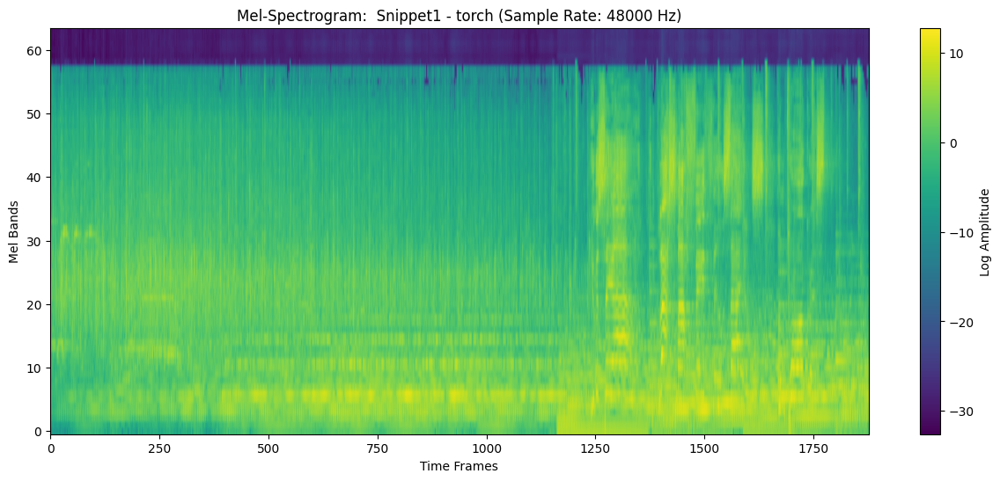

Spectrogram shape: float32 (64, 1877)


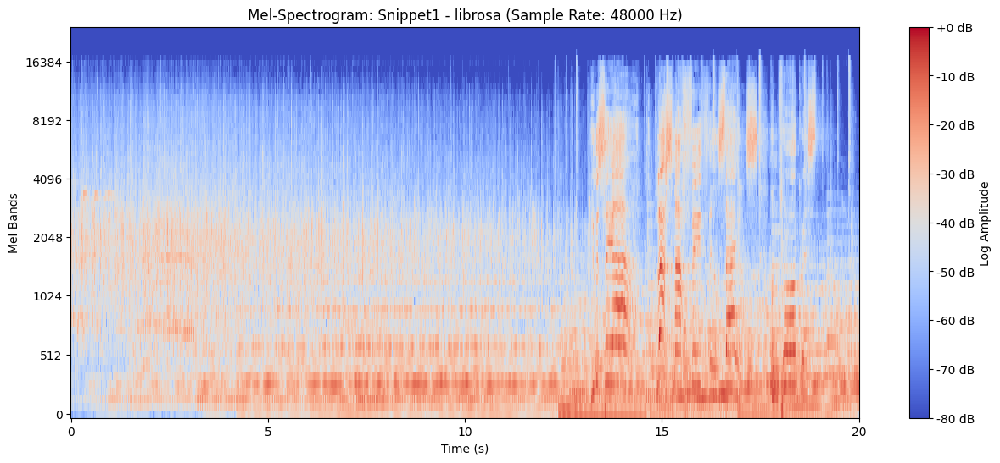

In [ ]:
load_audio_plot_melspec_torch(snippet1_path, title="Snippet1 - torch", n_fft=1024, hop_length=512, n_mels=64)
load_audio_plot_melspec_librosa(snippet1_path, title="Snippet1 - librosa", n_fft=1024, hop_length=512, n_mels=64)

Spectrogram shape: <built-in method type of Tensor object at 0x7bd405da9f30> torch.Size([1, 64, 1407])


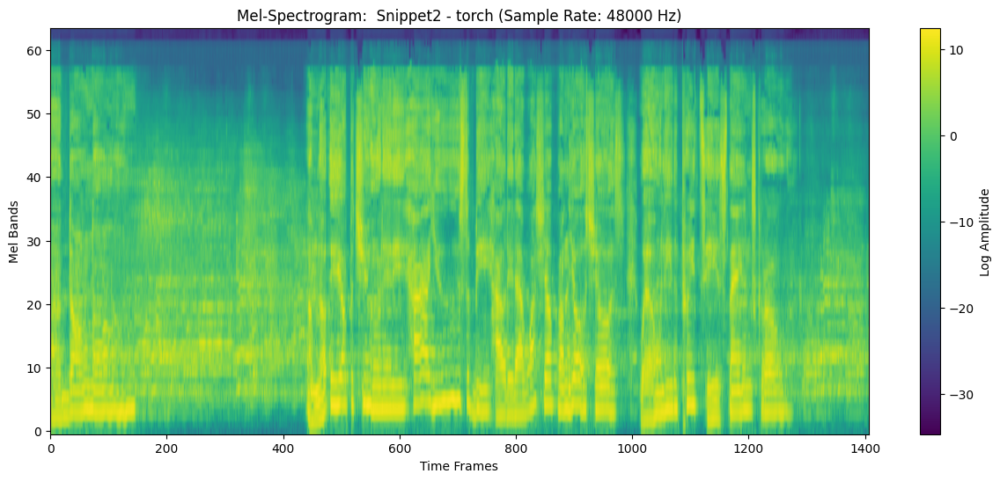

Spectrogram shape: float32 (64, 1407)


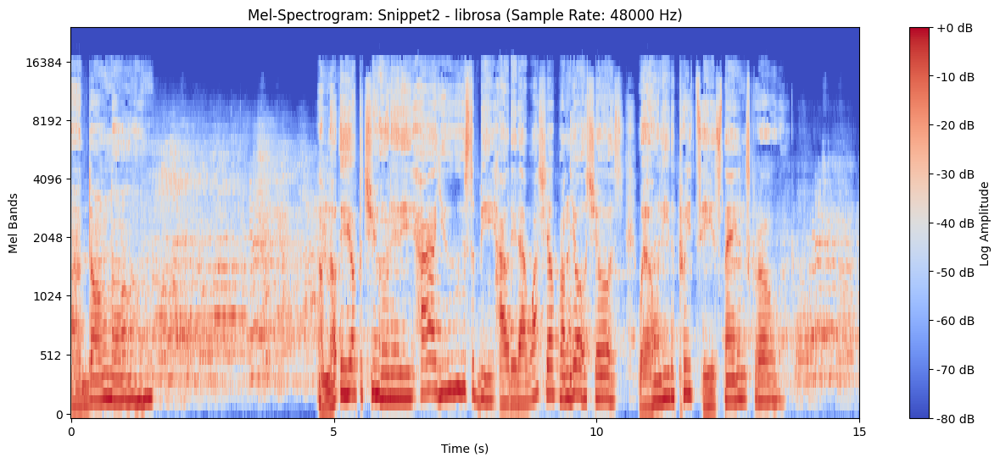

In [ ]:
load_audio_plot_melspec_torch(snippet2_path, title="Snippet2 - torch", n_fft=1024, hop_length=512, n_mels=64)
load_audio_plot_melspec_librosa(snippet2_path, title="Snippet2 - librosa", n_fft=1024, hop_length=512, n_mels=64)

### mel frequency cepstral coefficients (mfcc)

In [ ]:
# with torch
import torchaudio.transforms as T
import matplotlib.pyplot as plt

def load_audio_plot_mfcc_torch(file_path, title="MFCC", n_fft=1024, hop_length=512, n_mels=128, n_mfcc=13):
    # Load audio with torchaudio
    waveform, sample_rate = torchaudio.load(file_path)

    # Create an MFCC transform
    mfcc_transform = T.MFCC(sample_rate=sample_rate, n_mfcc=n_mfcc,
        melkwargs={
            "n_fft": n_fft,
            "hop_length": hop_length,
            "n_mels": n_mels,
        }
    )

    # Apply transform to waveform
    mfcc = mfcc_transform(waveform)

    print(f"MFCC shape: {mfcc.type} {mfcc.shape}")

    # Plot the MFCC
    plt.figure(figsize=(15, 6))
    plt.imshow(mfcc[0].detach().numpy(), aspect='auto', origin='lower')
    plt.title(f"MFCC: {title} (Sample Rate: {sample_rate} Hz)")
    plt.xlabel("Time Frames")
    plt.ylabel("MFCC Coefficients")
    plt.colorbar(label="Amplitude")
    plt.show()

    return

In [ ]:
# with mfcc
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

def load_audio_plot_mfcc_librosa(file_path, title="MFCC", n_fft=1024, hop_length=512, n_mels=128, n_mfcc=13):
    # Load audio with librosa
    y, sr = librosa.load(file_path, sr=None)  # Automatically resample if needed

    # Compute MFCCs
    mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)

    print(f"MFCC shape: {mfcc.dtype} {mfcc.shape}")

    # Plot the MFCCs
    plt.figure(figsize=(15, 6))
    librosa.display.specshow(mfcc, sr=sr, hop_length=hop_length, x_axis='time', y_axis='mel', cmap='coolwarm')
    plt.title(f"MFCC: {title} (Sample Rate: {sr} Hz)")
    plt.xlabel("Time (s)")
    plt.ylabel("MFCC Coefficients")
    plt.colorbar(format="%+2.0f dB", label="Amplitude")
    plt.show()

    return


MFCC shape: <built-in method type of Tensor object at 0x7bd405471710> torch.Size([2, 13, 1877])


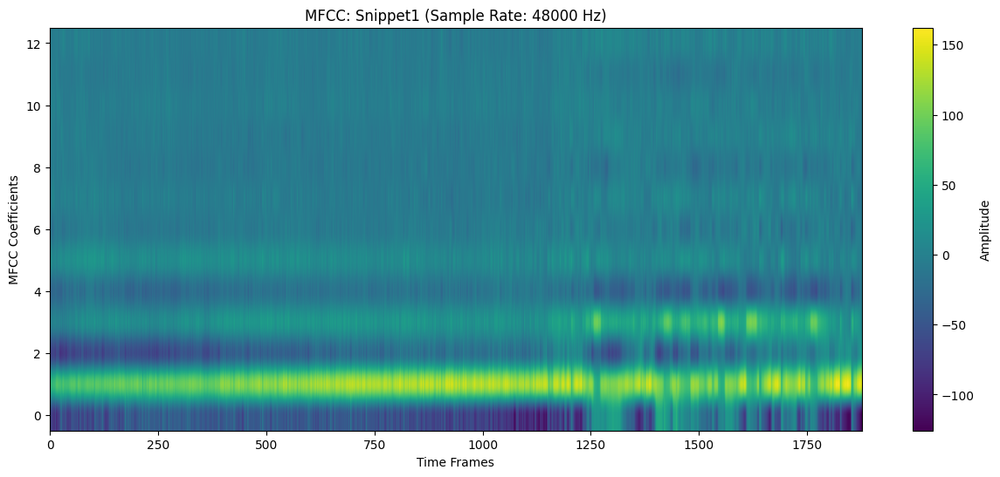

MFCC shape: float32 (13, 1877)


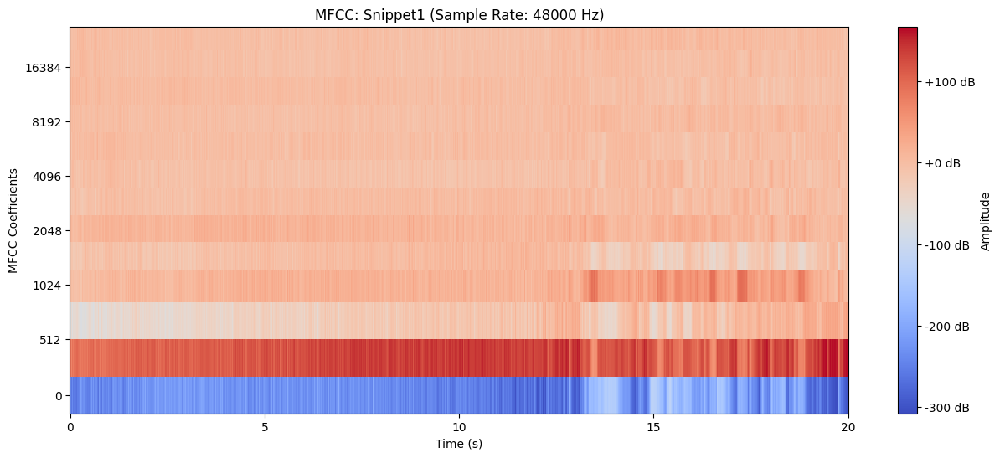

In [ ]:
load_audio_plot_mfcc_torch(snippet1_path, title="Snippet1", n_fft=1024, hop_length=512, n_mels=64, n_mfcc=13)
load_audio_plot_mfcc_librosa(snippet1_path, title="Snippet1", n_fft=1024, hop_length=512, n_mels=64, n_mfcc=13)

MFCC shape: <built-in method type of Tensor object at 0x7bd406441710> torch.Size([1, 13, 1407])


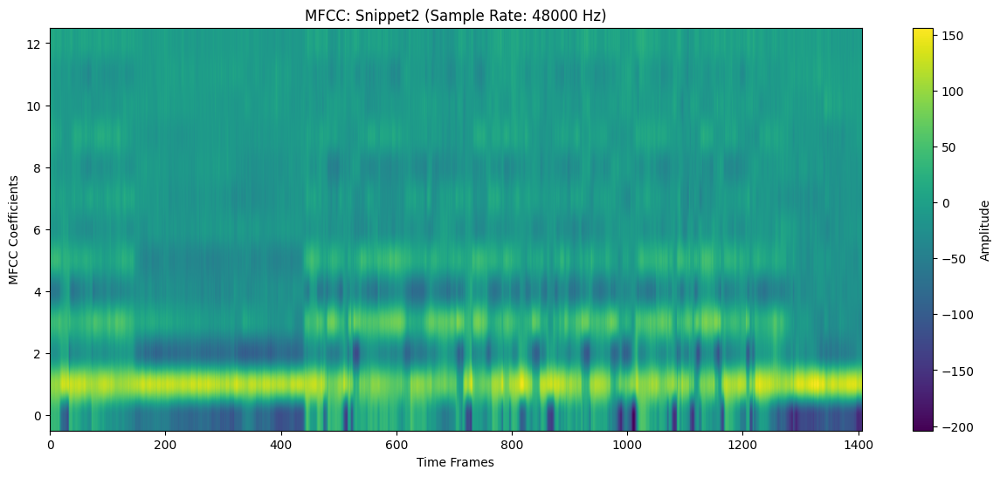

MFCC shape: float32 (13, 1407)


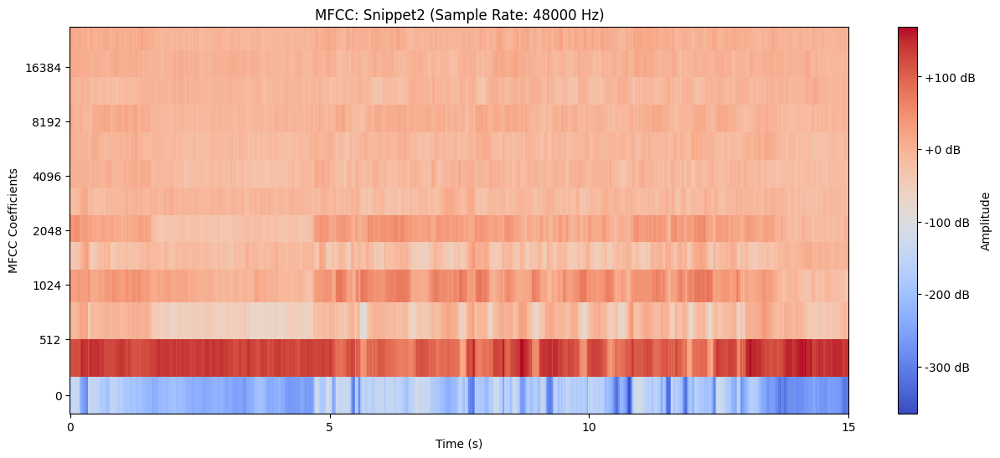

In [ ]:
load_audio_plot_mfcc_torch(snippet2_path, title="Snippet2", n_fft=1024, hop_length=512, n_mels=64, n_mfcc=13)
load_audio_plot_mfcc_librosa(snippet2_path, title="Snippet2", n_fft=1024, hop_length=512, n_mels=64, n_mfcc=13)

## other representations

### chroma

using librosa for this, as building it from `torchaudio.transforms` was not working properly

In [ ]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

def load_audio_plot_chroma(file_path, title="Chroma Features", n_fft=1024, hop_length=512, n_chroma=12):

    # Load audio with librosa
    y, sr = librosa.load(file_path, sr=None, mono=True)  # Automatically resample if needed

    # Compute the chroma features
    chroma = librosa.feature.chroma_stft(y=y, sr=sr, n_fft=n_fft, hop_length=hop_length, n_chroma=n_chroma)

    print(f"Chroma shape: {chroma.dtype} {chroma.shape}")

    # Define pitch class labels
    pitch_classes = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']

    # Plot chroma features
    plt.figure(figsize=(15, 6))
    librosa.display.specshow(chroma, x_axis='time', y_axis='chroma', sr=sr, hop_length=hop_length, cmap="coolwarm")
    plt.title(f"Chroma Features: {title}")
    plt.colorbar(label="Amplitude")
    plt.ylabel("Chroma Bins")
    plt.yticks(ticks=np.arange(len(pitch_classes)), labels=pitch_classes)
    plt.show()

    return


Chroma shape: float32 (12, 939)


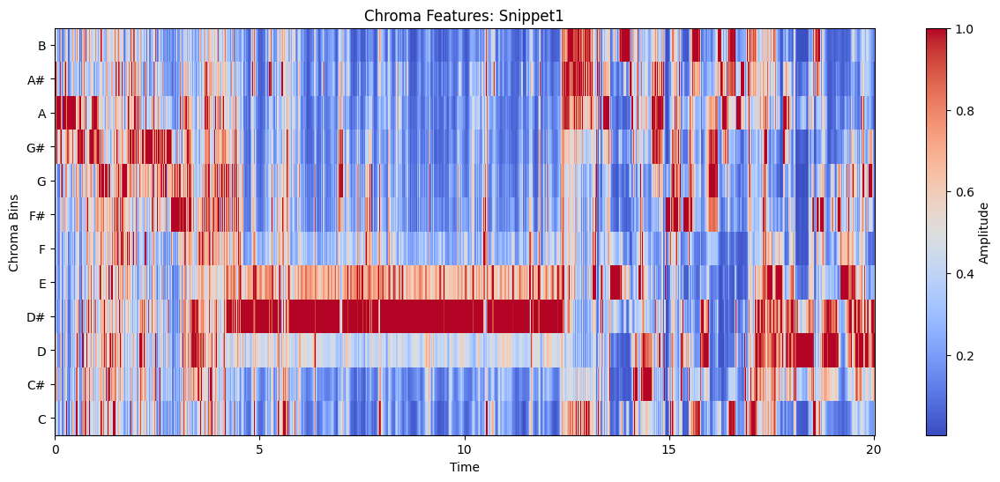

Chroma shape: float32 (12, 704)


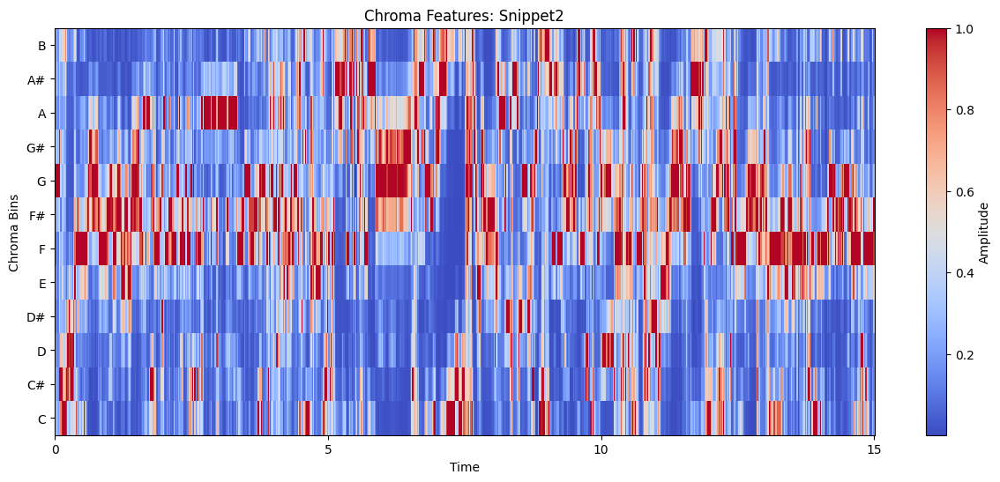

In [ ]:
load_audio_plot_chroma(snippet1_path, title="Snippet1", n_fft=2048, hop_length=1024, n_chroma=12)
load_audio_plot_chroma(snippet2_path, title="Snippet2", n_fft=2048, hop_length=1024, n_chroma=12)

comparing `chroma_stft` with `chroma_cqt` in `librosa`

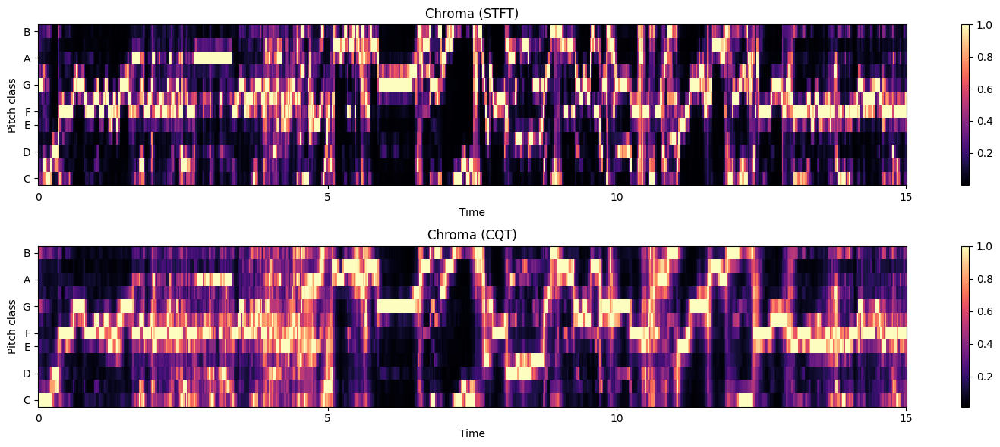

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt

# Load an audio file
y, sr = librosa.load(snippet2_path)

# Compute chroma features
chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr, n_fft=2048, hop_length=512)
chroma_cqt = librosa.feature.chroma_cqt(y=y, sr=sr, hop_length=512)

# Plot the chroma features
plt.figure(figsize=(15, 6))

plt.subplot(2, 1, 1)
librosa.display.specshow(chroma_stft, sr=sr, x_axis='time', y_axis='chroma')
plt.colorbar()
plt.title("Chroma (STFT)")

plt.subplot(2, 1, 2)
librosa.display.specshow(chroma_cqt, sr=sr, x_axis='time', y_axis='chroma')
plt.colorbar()
plt.title("Chroma (CQT)")

plt.tight_layout()
plt.show()


### tempo estimation

let us first get a more musical example at `zeal_path` and analyze it using the previous plotting functions

In [ ]:
waveform3, sample_rate3 = torchaudio.load(zeal_path)

print(f'Zeal & Ardor - Götterdämmerung: {waveform3.size(dim=0)} channel(s), with {waveform3.size(dim=-1)} samples, with a {sample_rate3}Hz sample rate.')
Audio(zeal_path) # this seems to only display for .mp3 files, .wav did not work

Zeal & Ardor - Götterdämmerung: 2 channel(s), with 8791244 samples, with a 48000Hz sample rate.


Waveform shape: float32 (8791244,)


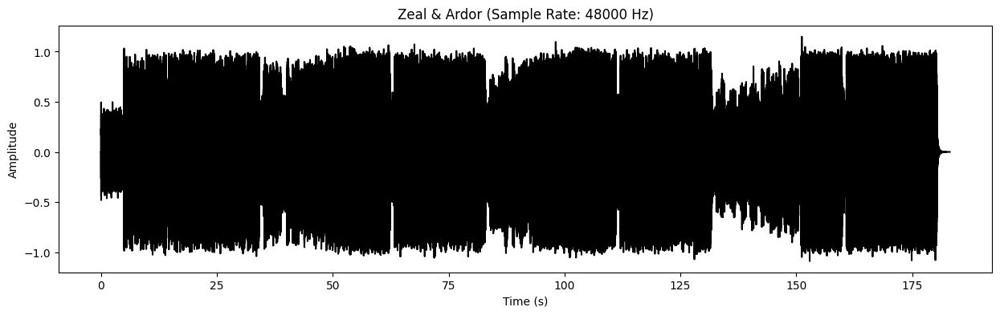

In [ ]:
load_audio_plot_waveform_librosa(zeal_path, color='black', title='Zeal & Ardor')

Spectrogram shape: float32 (513, 17171)


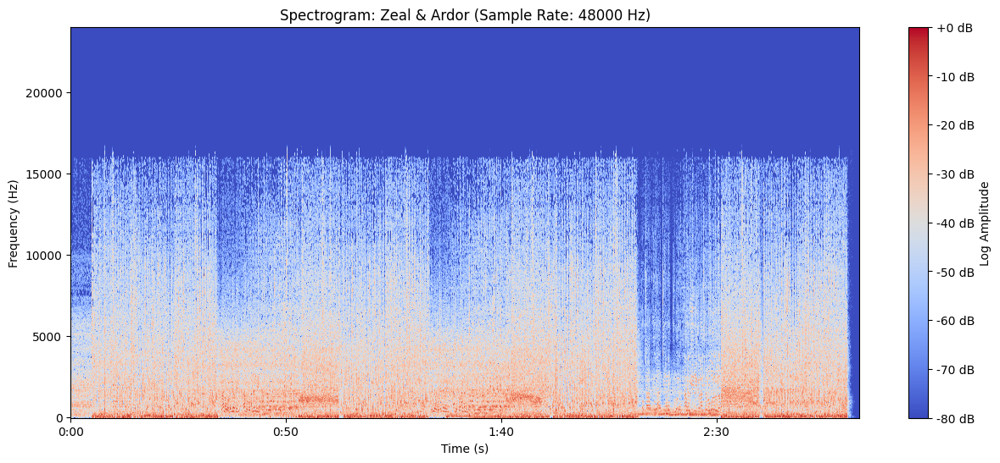

In [ ]:
load_audio_plot_spectrogram_librosa(zeal_path, title='Zeal & Ardor')

Spectrogram shape: float32 (128, 17171)


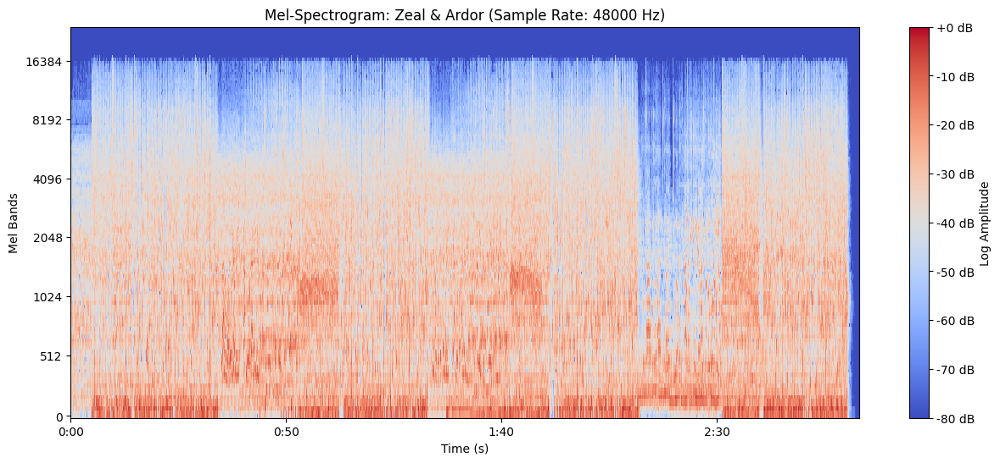

In [ ]:
load_audio_plot_melspec_librosa(zeal_path, title='Zeal & Ardor')

MFCC shape: float32 (13, 17171)


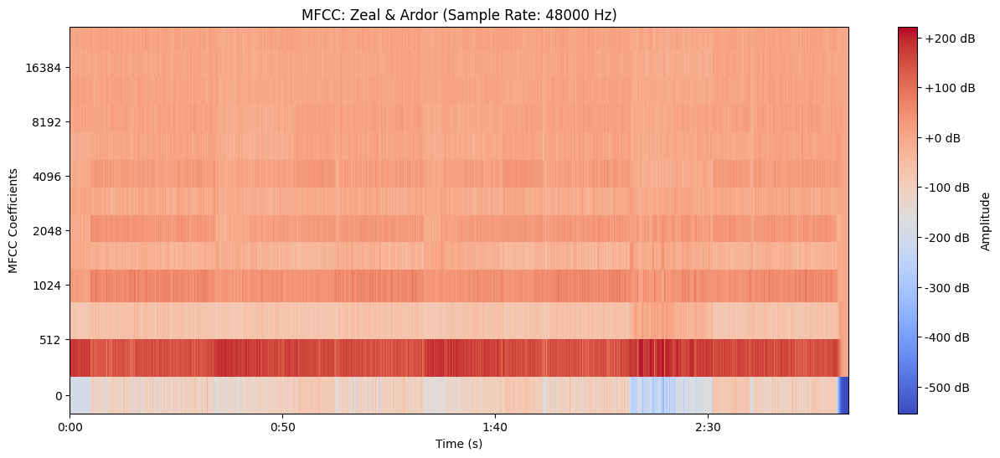

In [ ]:
load_audio_plot_mfcc_librosa(zeal_path, title='Zeal & Ardor')

Chroma shape: float32 (12, 8586)


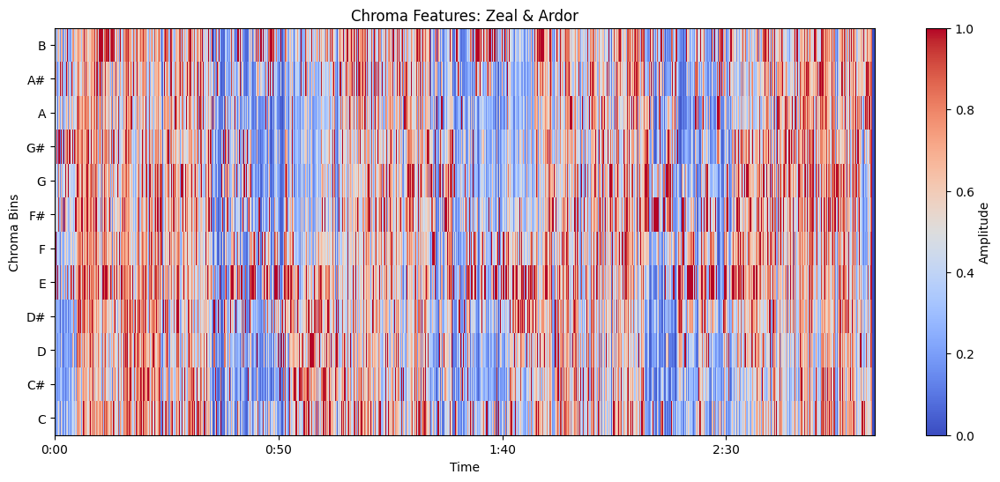

In [ ]:
load_audio_plot_chroma(zeal_path, title='Zeal & Ardor', n_fft=2048, hop_length=1024, n_chroma=12)

basically, it detects onsets and uses an autocorrelation-based method to identify the dominant periodicity, translating it into BPM



In [ ]:
# with torch
def estimate_tempo_torch(file_path, hop_length=512, min_tempo=30, max_tempo=300):
    # Step 1: Load audio
    waveform, sample_rate = torchaudio.load(file_path)

    # Convert to mono if multi-channel
    if waveform.shape[0] > 1:
        waveform = waveform.mean(dim=0, keepdim=True)

    # Step 2: Compute the onset envelope
    spectrogram_transform = torchaudio.transforms.Spectrogram(n_fft=1024, hop_length=hop_length, power=2)
    spectrogram = spectrogram_transform(waveform)  # Shape: [1, n_freq_bins, time_frames]
    onset_envelope = torch.mean(torch.abs(spectrogram[0]), dim=0)  # Aggregate across frequencies

    # Normalize onset envelope
    onset_envelope -= onset_envelope.min()
    if onset_envelope.max() > 0:
        onset_envelope /= onset_envelope.max()
    else:
        raise ValueError("Onset envelope has no variation after normalization.")

    # Smooth the onset envelope
    onset_envelope = torch.nn.functional.avg_pool1d(
        onset_envelope.unsqueeze(0), kernel_size=5, stride=1, padding=2
    ).squeeze()

    # Step 3: Compute autocorrelation directly
    autocorr = torch.zeros(onset_envelope.shape[-1])
    for lag in range(1, onset_envelope.shape[-1]):
        autocorr[lag] = torch.sum(onset_envelope[:-lag] * onset_envelope[lag:])

    # Normalize autocorrelation
    autocorr -= autocorr.min()
    if autocorr.max() > 0:
        autocorr /= autocorr.max()

    # Step 4: Filter lags within a valid range
    lag_min = int(sample_rate / (max_tempo * hop_length / 60))  # Shortest lag (highest tempo)
    lag_max = int(sample_rate / (min_tempo * hop_length / 60))  # Longest lag (lowest tempo)

    # Clip autocorrelation outside lag range
    autocorr[:lag_min] = 0
    autocorr[lag_max:] = 0

    # Step 5: Find periodicity
    peaks = torch.argmax(autocorr)  # Find the lag with the highest autocorrelation
    period = peaks.item()

    # Step 6: Convert periodicity to BPM
    tempo = 60 * sample_rate / (period * hop_length)
    return tempo


In [ ]:
import librosa

def estimate_tempo_librosa(file_path, start_bpm=120.0, hop_length=512):
    # Load the audio file
    y, sr = librosa.load(file_path)

    # Estimate tempo using librosa
    tempo, _ = librosa.beat.beat_track(y=y, sr=sr, start_bpm=start_bpm, hop_length=hop_length)

    # Explicitly extract the scalar value
    tempo = tempo[0] if isinstance(tempo, np.ndarray) else tempo

    return tempo


In [ ]:
zeal_tempo_torch = estimate_tempo_torch(zeal_path)
print(f"Estimated tempo for Zeal & Ardor with torch: {zeal_tempo_torch:.2f} BPM")

Estimated tempo for Zeal & Ardor with torch: 200.89 BPM


In [ ]:
zeal_tempo_librosa = estimate_tempo_librosa(zeal_path)
print(f"Estimated tempo for Zeal & Ardor with librosa: {zeal_tempo_librosa:.2f} BPM")

Estimated tempo for Zeal & Ardor with librosa: 99.38 BPM


In [ ]:
import librosa
import numpy as np
import soundfile as sf

def add_metronome_simple(audio_path, output_path, bpm):
    # Load the audio file
    y, sr = librosa.load(audio_path)

    # Calculate the time interval between beats in seconds
    beat_interval = 60 / bpm

    # Generate beat times from 0 to the duration of the audio
    duration = librosa.get_duration(y=y, sr=sr)
    beat_times = np.arange(0, duration, beat_interval)

    # Generate clicks at the beat times
    clicks = librosa.clicks(times=beat_times, sr=sr, length=len(y), click_freq=1000.0, click_duration=0.03)

    # Combine the original audio with the metronome clicks
    combined_audio = y + clicks

    # Normalize the combined audio to avoid clipping
    combined_audio = combined_audio / np.max(np.abs(combined_audio))

    # Save the resulting audio file
    sf.write(output_path, combined_audio, sr)

    print(f"Saved audio with metronome to: {output_path}")


In [ ]:
# with torch
output_path = os.path.join(mirelo_path, 'zeal_metronome_torch.mp3')
add_metronome_simple(zeal_path, output_path, bpm=zeal_tempo_torch)

Saved audio with metronome to: /content/drive/MyDrive/audio-do/mirelo-interview/zeal_metronome_torch.mp3


In [ ]:
Audio(os.path.join(mirelo_path, 'zeal_metronome_torch.mp3'))

In [ ]:
# with librosa
output_path = os.path.join(mirelo_path, 'zeal_metronome_librosa.mp3')
add_metronome_simple(zeal_path, output_path, bpm=zeal_tempo_librosa)

Saved audio with metronome to: /content/drive/MyDrive/audio-do/mirelo-interview/zeal_metronome_librosa.mp3


In [ ]:
Audio(os.path.join(mirelo_path, 'zeal_metronome_librosa.mp3'))

# feature extraction / audio ml tasks

## learned represetations from pretrained models

In [ ]:
import torch

if torch.cuda.is_available():
    print(f"GPU is available: {torch.cuda.get_device_name(0)}")
else:
    print("GPU is not available. Using CPU.")


GPU is available: Tesla T4


### wav2vec

In [ ]:
!pip install transformers torchaudio librosa

In [ ]:
import torch
import torchaudio
from transformers import Wav2Vec2Processor, Wav2Vec2Model

def extract_wav2vec_embeddings_torch(audio_path, model_name="facebook/wav2vec2-base", target_sr=16000):
    # Load the pretrained processor and model
    processor = Wav2Vec2Processor.from_pretrained(model_name) # normalizes/tokenizes waveforms to make it compatible with Wav2Vec
    model = Wav2Vec2Model.from_pretrained(model_name).to("cuda")  # pretrained model to gpu

    # Load audio with torchaudio
    waveform, sr = torchaudio.load(audio_path)

    # Resample the audio if necessary
    if sr != target_sr:
        resampler = torchaudio.transforms.Resample(orig_freq=sr, new_freq=target_sr)
        waveform = resampler(waveform)
        sr = target_sr

    # Convert to mono if necessary
    if waveform.shape[0] > 1:  # If multi-channel, average to mono
        waveform = waveform.mean(dim=0, keepdim=True)

    # Normalize the waveform
    waveform = waveform / waveform.abs().max()

    # Preprocess input for Wav2Vec2
    input_values = processor(waveform.squeeze(0).numpy(), sampling_rate=sr, return_tensors="pt").input_values.to("cuda")
    print(f"Input values shape: {input_values.shape}")

    # Extract embeddings
    with torch.no_grad():
        embeddings = model(input_values).last_hidden_state
        if embeddings.device != torch.device("cpu"): # Move embeddings back to CPU if needed
            embeddings = embeddings.cpu()

    print(f"Embeddings shape: {embeddings.shape}")
    return embeddings     # Shape: [batch_size, seq_len, hidden_size]


In [ ]:
wav2vec_embeddings = extract_wav2vec_embeddings_torch(zeal_path)

/usr/local/lib/python3.10/dist-packages/transformers/configuration_utils.py:306: UserWarning: Passing `gradient_checkpointing` to a config initialization is deprecated and will be removed in v5 Transformers. Using `model.gradient_checkpointing_enable()` instead, or if you are using the `Trainer` API, pass `gradient_checkpointing=True` in your `TrainingArguments`.
  warnings.warn(


Input values shape: torch.Size([1, 2930415])
cuda:0
Embeddings shape: torch.Size([1, 9157, 768])


### huBERT

although mostly used for speech tasks

In [ ]:
import torch
import torchaudio
from transformers import Wav2Vec2Processor, HubertModel

def extract_hubert_embeddings_torch(audio_path, model_name="facebook/hubert-large-ls960-ft", target_sr=16000):
    # Load the pretrained processor and model
    processor = Wav2Vec2Processor.from_pretrained(model_name)
    model = HubertModel.from_pretrained(model_name).to("cuda")

    # Load audio with torchaudio
    waveform, sr = torchaudio.load(audio_path)

    # Resample the audio if necessary
    if sr != target_sr:
        resampler = torchaudio.transforms.Resample(orig_freq=sr, new_freq=target_sr)
        waveform = resampler(waveform)
        sr = target_sr

    # Convert to mono if necessary
    if waveform.shape[0] > 1:  # If multi-channel, average to mono
        waveform = waveform.mean(dim=0, keepdim=True)

    # Normalize the waveform
    waveform = waveform / waveform.abs().max()

    # Preprocess input for HuBERT
    input_values = processor(waveform.squeeze(0).numpy(), sampling_rate=sr, return_tensors="pt").input_values.to('cuda')
    print(f"Input values shape: {input_values.shape}")

    # Extract embeddings
    with torch.no_grad():
        embeddings = model(input_values).last_hidden_state
        if embeddings.device != torch.device("cpu"): # Move embeddings back to CPU if needed
            embeddings = embeddings.cpu()

    print(f"Embeddings shape: {embeddings.shape}")
    return embeddings # Shape: [batch_size, seq_len, hidden_size]


In [ ]:
hubert_embeddings = extract_hubert_embeddings_torch(zeal_path)

Input values shape: torch.Size([1, 2930415])
Embeddings shape: torch.Size([1, 9157, 1024])


### neural audio codecs

#### enCodec

In [ ]:
!pip install encodec

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 49.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for encodec: filename=encodec-0.1.1-py3-none-any.whl size=45760 sha256=cc262938d2eaabf4afd2a7c9e00d676a60f3c53d637307c5399e25487f3e3a11
  Stored in directory: /root/.cache/pip/wheels/fc/36/cb/81af8b985a5f5e0815312d5e52b41263237af07b977e6bcbf3
Successfully built encodec


In [166]:
import torch
import torchaudio
from encodec import EncodecModel
from encodec.utils import convert_audio

def extract_encodec_latents_and_audio(audio_path, target_sr=24000, original_sr=48000):
    """
    Returns:
        list[torch.Tensor]: Latent representations of the audio.
        torch.Tensor: Processed input audio (resampled and normalized).
        torch.Tensor: Reconstructed audio resampled to the original sample rate.
        int: Original sample rate of the audio.
    """
    # Check for GPU availability
    device = "cuda" if torch.cuda.is_available() else "cpu"

    # Load the pre-trained EnCodec model and move it to GPU
    model = EncodecModel.encodec_model_24khz()
    model.set_target_bandwidth(12.0) # higher -> more codebooks / better quality
    model.eval().to(device)

    # Load audio
    waveform, sr = torchaudio.load(audio_path)
    print(f"Original sample rate: {sr}, Waveform shape: {waveform.shape}")

    # Resample audio to the target sample rate
    if sr != target_sr:
        resampler = torchaudio.transforms.Resample(orig_freq=sr, new_freq=target_sr)
        waveform = resampler(waveform)

    resampled_duration = waveform.shape[-1] / target_sr
    print(f"Resampled waveform duration: {resampled_duration:.2f} seconds")
    print(f"Waveform shape after resampling: {waveform.shape}")

    # Normalize waveform
    waveform = waveform / waveform.abs().max()

    # Convert waveform for EnCodec
    print(f"Waveform shape before convert_audio: {waveform.shape}, Channels: {waveform.shape[0]}")
    audio = convert_audio(waveform, target_sr, model.sample_rate, model.channels)
    print(f"Audio shape after convert_audio: {audio.shape}")

    # Ensure correct shape: [batch_size, channels, time_samples]
    if audio.dim() == 2:  # Shape [batch_size, time_samples] without channels
        audio = audio.unsqueeze(1)  # Add channel dimension

    audio_duration_in = audio.shape[-1] / target_sr
    print(f"Processed input audio duration: {audio_duration_in:.2f} seconds")

    # Move audio to GPU
    audio = audio.to(device)

    # Extract latent representations
    with torch.no_grad():
        encoded = model.encode(audio)

        # Decode audio from latents
        reconstructed_audio = model.decode(encoded)

    return encoded, audio, reconstructed_audio, target_sr


In [167]:
encodec_latents, audio_in, audio_out, sr = extract_encodec_latents_and_audio(zeal_path)

Original sample rate: 48000, Waveform shape: torch.Size([2, 8791244])
Resampled waveform duration: 183.15 seconds
Waveform shape after resampling: torch.Size([2, 4395622])
Waveform shape before convert_audio: torch.Size([2, 4395622]), Channels: 2
Audio shape after convert_audio: torch.Size([1, 4395622])
Processed input audio duration: 183.15 seconds


In [ ]:
# the audio that gets fed to EnCoded after processing
Audio(audio_in.squeeze(0).cpu().numpy(), rate=sr)

In [ ]:
# the audio that gets generated by EnCoded
Audio(audio_out.squeeze(0).cpu().numpy(), rate=sr)

In [ ]:
# Inspect the structure of the encodec_latents object
print(f"Type of encodec_latents: {type(encodec_latents)}")
print(f"Contents of encodec_latents: {encodec_latents}")

Type of encodec_latents: <class 'list'>
Contents of encodec_latents: [(tensor([[[ 738,  562,  951,  ...,   62,   62,   62],
         [ 931,  649,  201,  ...,  518,  518,  518],
         [ 626,  803,  787,  ...,  786,  786,  786],
         ...,
         [ 842,  983,  712,  ...,  848,  848,  848],
         [1022,  408,  787,  ...,  705,  705,  705],
         [ 744, 1019,  812,  ...,  907,  907,  907]]], device='cuda:0'), None)]


`encodec_latents` is a list of tuples:
- `tensor` in the first element
- a placeholder returning `None` in the second element

In [ ]:
# Access the tensor and print its shape
latent_tensor = encodec_latents[0][0]
print(f"Shape of the latent tensor: {latent_tensor.shape}")

Shape of the latent tensor: torch.Size([1, 16, 13737])


- `1`: Batch size (single audio input).
- `8`: Number of quantization levels (or "codebooks"). Each codebook captures different aspects of the audio (e.g., pitch, timbre, rhythm).
- `13737`: Time frames. This depends on the duration of the audio and the model's downsampling rate (usually a factor of x320)

In [148]:
audio_out.shape

torch.Size([1, 1, 4395840])

In [164]:
# let us compare sizes
torchaudio.save(os.path.join(mirelo_path, "zeal_encoded.wav"), audio_out.squeeze(0).cpu(), sample_rate=sr)

encodec_file_size = os.path.getsize(os.path.join(mirelo_path, "zeal_encoded.wav"))
original_file_size = os.path.getsize(os.path.join(mirelo_path, "zealArdor_Götterdämmerung.wav"))

print(f"Original file size: {original_file_size / 1024:.2f} KB")
print(f"Reconstructed file size (.wav): {encodec_file_size / 1024:.2f} KB")

Original file size: 8687.11 KB
Reconstructed file size (.wav): 8585.70 KB


this does not reflect the compression given the smaller bitrate, because of the conversion to `.wav` when saving

In [168]:
# Save the latent representations as a .pt file
torch.save(encodec_latents, os.path.join(mirelo_path, "zeal_latents.pt"))

latents_file_size = os.path.getsize(os.path.join(mirelo_path, "zeal_latents.pt"))

print(f"Original file size: {original_file_size / 1024:.2f} KB")
print(f"Reconstructed file size (latents): {latents_file_size / 1024:.2f} KB")

Original file size: 8687.11 KB
Reconstructed file size (latents): 1718.30 KB


## musical genre classification

## music source separation